<a href="https://colab.research.google.com/github/barzansaeedpour/python-exercises/blob/main/Matplotlib_Exercises_Answers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Matplotlib Exercises
Loading the dataset:

In [30]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

url = "https://raw.githubusercontent.com/datasciencedojo/datasets/master/titanic.csv"
df = pd.read_csv(url)


Plot a bar chart of the number of passengers in each class:

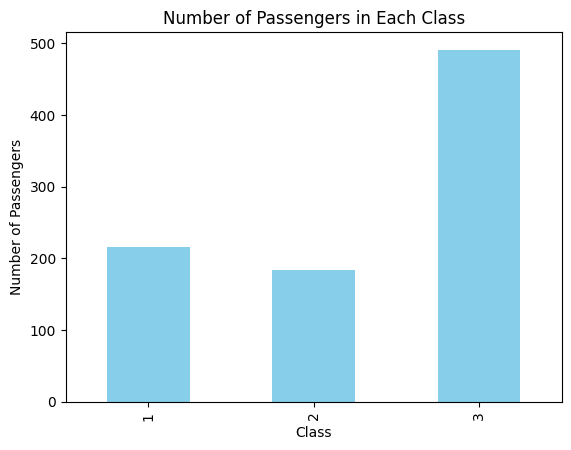

In [31]:
df['Pclass'].value_counts().sort_index().plot(kind='bar', color='skyblue')
plt.title('Number of Passengers in Each Class')
plt.xlabel('Class')
plt.ylabel('Number of Passengers')
plt.show()


Create a histogram of passenger ages:

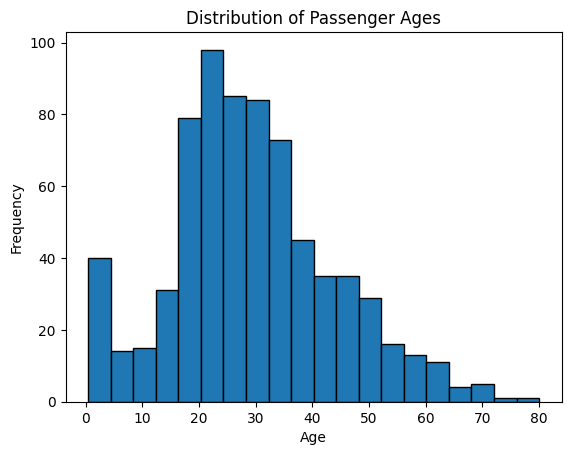

In [32]:
df['Age'].plot(kind='hist', bins=20, edgecolor='black')
plt.title('Distribution of Passenger Ages')
plt.xlabel('Age')
plt.ylabel('Frequency')
plt.show()


Plot a pie chart of the survival rate (survived vs not survived):

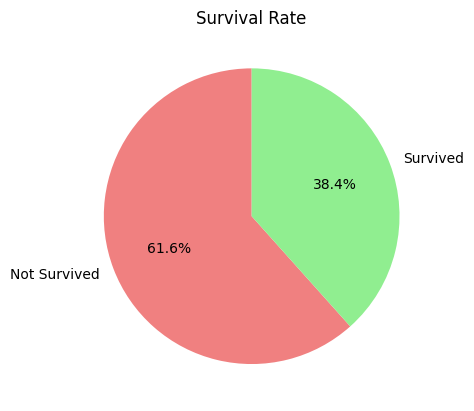

In [33]:
survival_counts = df['Survived'].value_counts()
survival_counts.plot(kind='pie', labels=['Not Survived', 'Survived'], autopct='%1.1f%%', startangle=90, colors=['lightcoral', 'lightgreen'])
plt.title('Survival Rate')
plt.ylabel('')
plt.show()


Create a scatter plot of age vs fare with different colors for survived vs not survived:

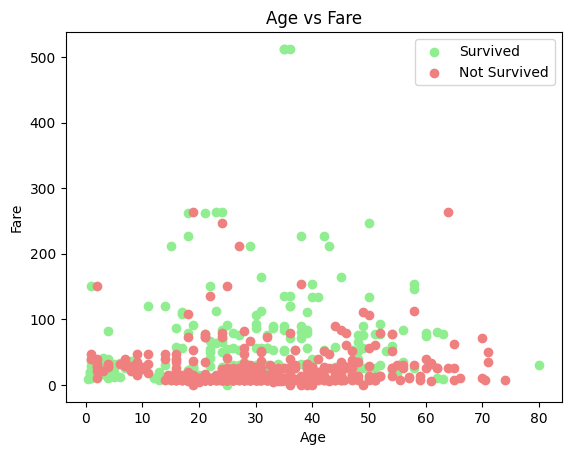

In [34]:
plt.scatter(df[df['Survived'] == 1]['Age'], df[df['Survived'] == 1]['Fare'], color='lightgreen', label='Survived')
plt.scatter(df[df['Survived'] == 0]['Age'], df[df['Survived'] == 0]['Fare'], color='lightcoral', label='Not Survived')
plt.title('Age vs Fare')
plt.xlabel('Age')
plt.ylabel('Fare')
plt.legend()
plt.show()


Plot a boxplot of passenger ages grouped by class:

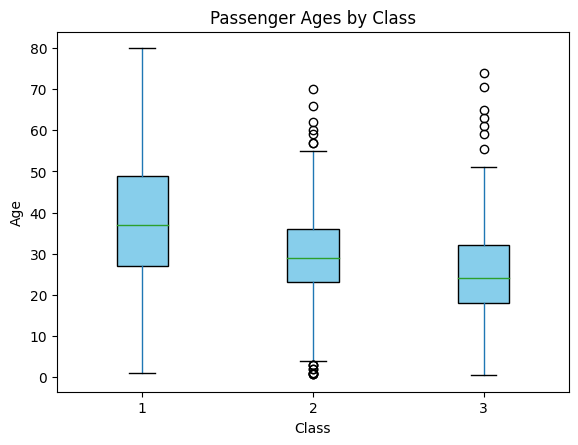

In [35]:
df.boxplot(column='Age', by='Pclass', grid=False, patch_artist=True, boxprops=dict(facecolor='skyblue'))
plt.title('Passenger Ages by Class')
plt.suptitle('')
plt.xlabel('Class')
plt.ylabel('Age')
plt.show()


Create a line plot of the average fare over different age groups:

<ipython-input-36-c1d38962370e>:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  avg_fare_by_age_group = df.groupby('AgeGroup')['Fare'].mean()


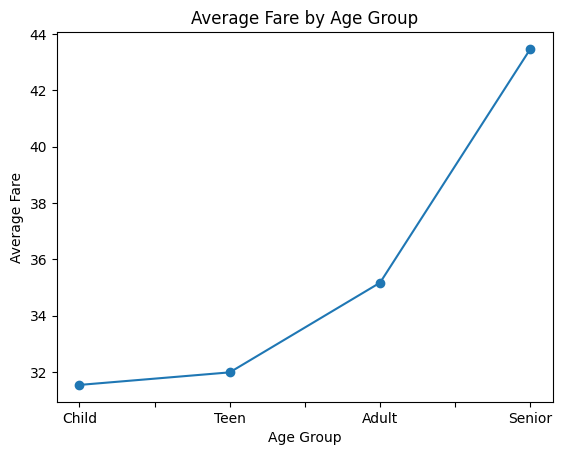

In [36]:
df['AgeGroup'] = pd.cut(df['Age'], bins=[0, 12, 19, 59, 99], labels=['Child', 'Teen', 'Adult', 'Senior'])
avg_fare_by_age_group = df.groupby('AgeGroup')['Fare'].mean()
avg_fare_by_age_group.plot(kind='line', marker='o', linestyle='-')
plt.title('Average Fare by Age Group')
plt.xlabel('Age Group')
plt.ylabel('Average Fare')
plt.show()


Plot a heatmap of the correlation matrix:

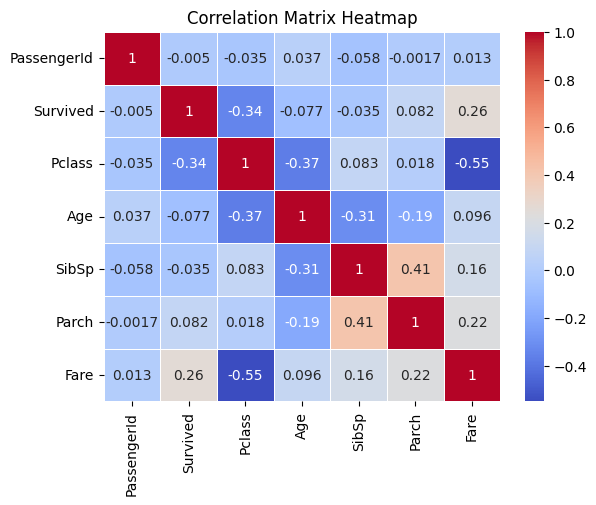

In [37]:
numeric_df = df.select_dtypes(include=[np.number])
correlation_matrix = numeric_df.corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Matrix Heatmap')
plt.show()


Create a pairplot of the numeric columns in the dataset:

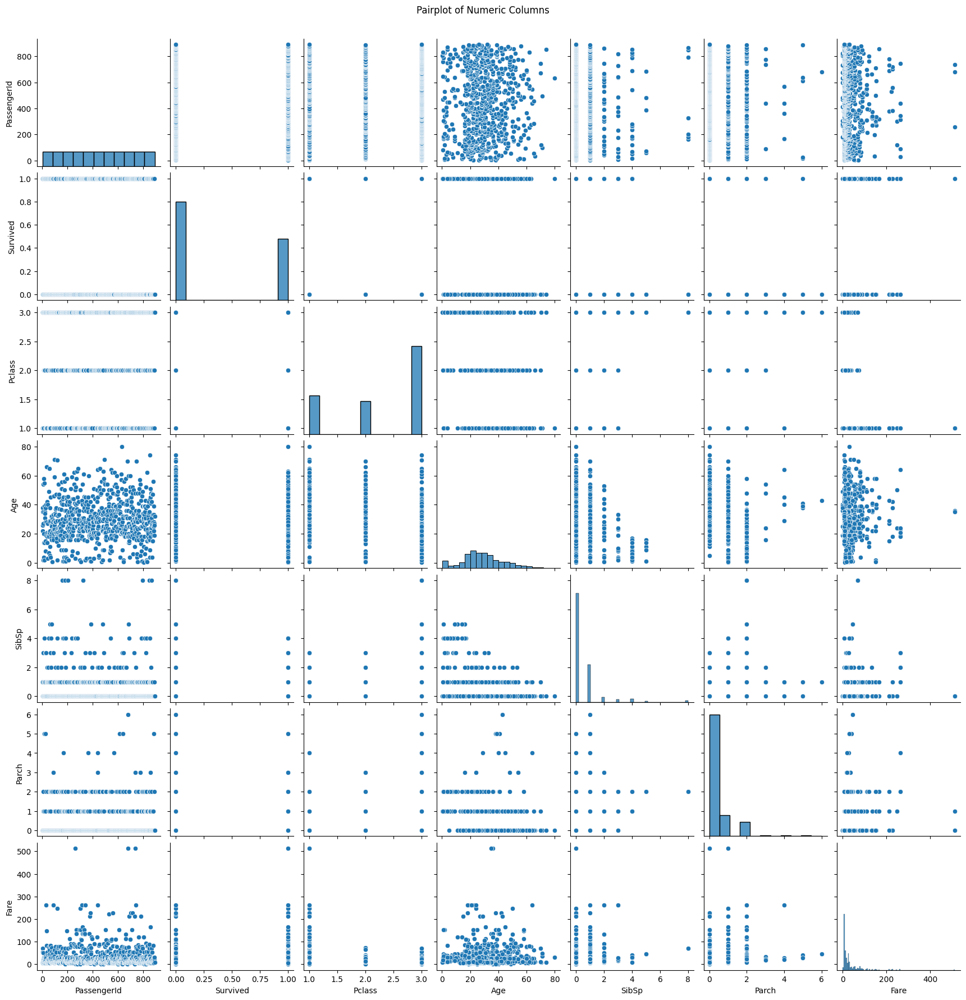

In [38]:
sns.pairplot(df.select_dtypes(include=[np.number]))
plt.suptitle('Pairplot of Numeric Columns', y=1.02)
plt.show()


Plot the survival rate by gender using a bar chart:

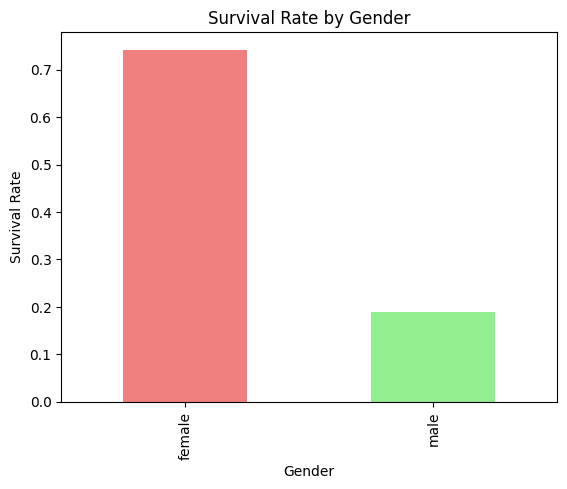

In [39]:
survival_rate_by_gender = df.groupby('Sex')['Survived'].mean()
survival_rate_by_gender.plot(kind='bar', color=['lightcoral', 'lightgreen'])
plt.title('Survival Rate by Gender')
plt.xlabel('Gender')
plt.ylabel('Survival Rate')
plt.show()


Create a stacked bar chart of the number of passengers by class and survival status:

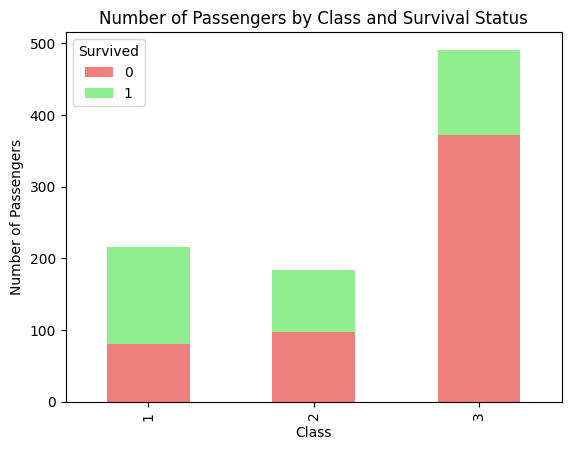

In [40]:
df.groupby(['Pclass', 'Survived']).size().unstack().plot(kind='bar', stacked=True, color=['lightcoral', 'lightgreen'])
plt.title('Number of Passengers by Class and Survival Status')
plt.xlabel('Class')
plt.ylabel('Number of Passengers')
plt.show()


Visualize the distribution of fares among different classes with a violin plot:

<ipython-input-41-b4a0b578990b>:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='Pclass', y='Fare', data=df, inner='quart', palette='muted')


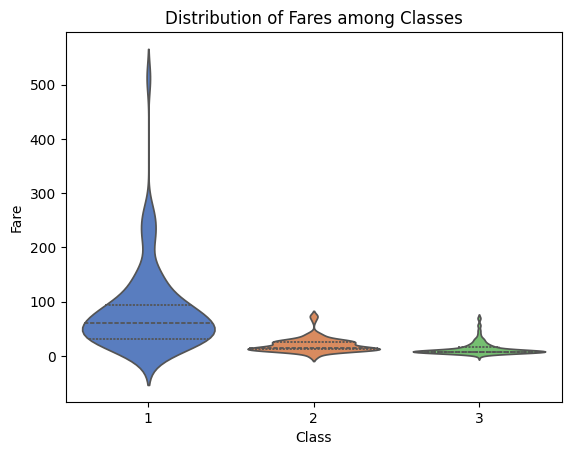

In [41]:
sns.violinplot(x='Pclass', y='Fare', data=df, inner='quart', palette='muted')
plt.title('Distribution of Fares among Classes')
plt.xlabel('Class')
plt.ylabel('Fare')
plt.show()


Create a subplot with two charts: one for the age distribution and one for fare distribution:

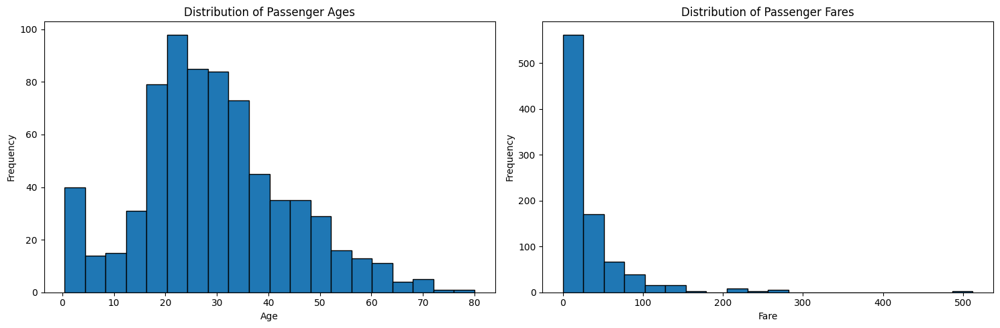

In [42]:
fig, axes = plt.subplots(1, 2, figsize=(15, 5))

# Age distribution
axes[0].hist(df['Age'].dropna(), bins=20, edgecolor='black')
axes[0].set_title('Distribution of Passenger Ages')
axes[0].set_xlabel('Age')
axes[0].set_ylabel('Frequency')

# Fare distribution
axes[1].hist(df['Fare'], bins=20, edgecolor='black')
axes[1].set_title('Distribution of Passenger Fares')
axes[1].set_xlabel('Fare')
axes[1].set_ylabel('Frequency')

plt.tight_layout()
plt.show()


Create a pairplot with hue set to 'Survived' and adjust the aesthetics:

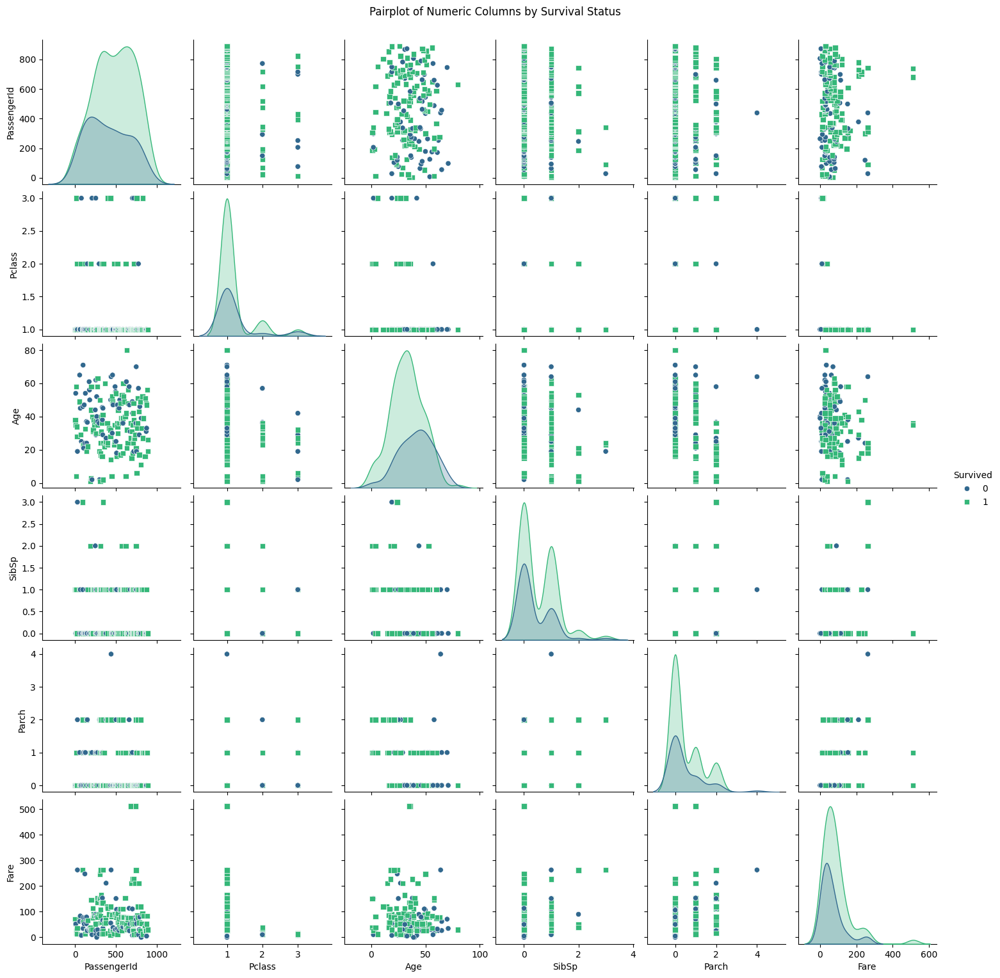

In [43]:
sns.pairplot(df.dropna(), hue='Survived', palette='viridis', markers=["o", "s"], diag_kind='kde')
plt.suptitle('Pairplot of Numeric Columns by Survival Status', y=1.02)
plt.show()


Plot a regression line for Age vs Fare with a confidence interval:

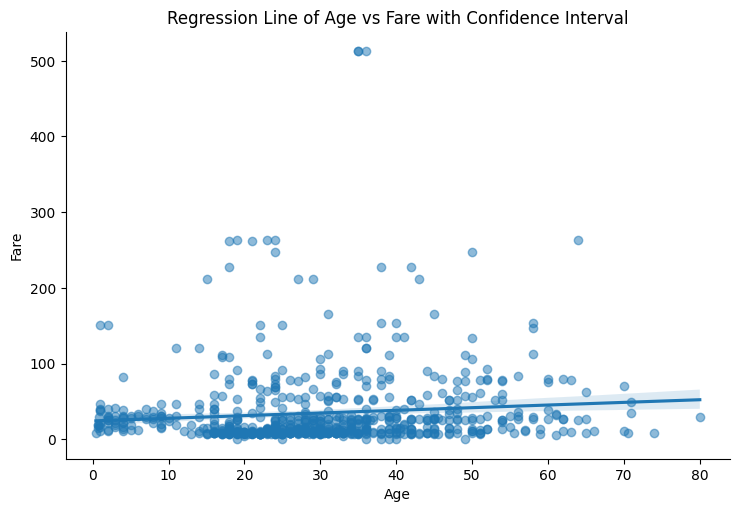

In [44]:
sns.lmplot(x='Age', y='Fare', data=df, aspect=1.5, scatter_kws={'alpha':0.5})
plt.title('Regression Line of Age vs Fare with Confidence Interval')
plt.xlabel('Age')
plt.ylabel('Fare')
plt.show()


Create a FacetGrid of survival rate by class and gender:

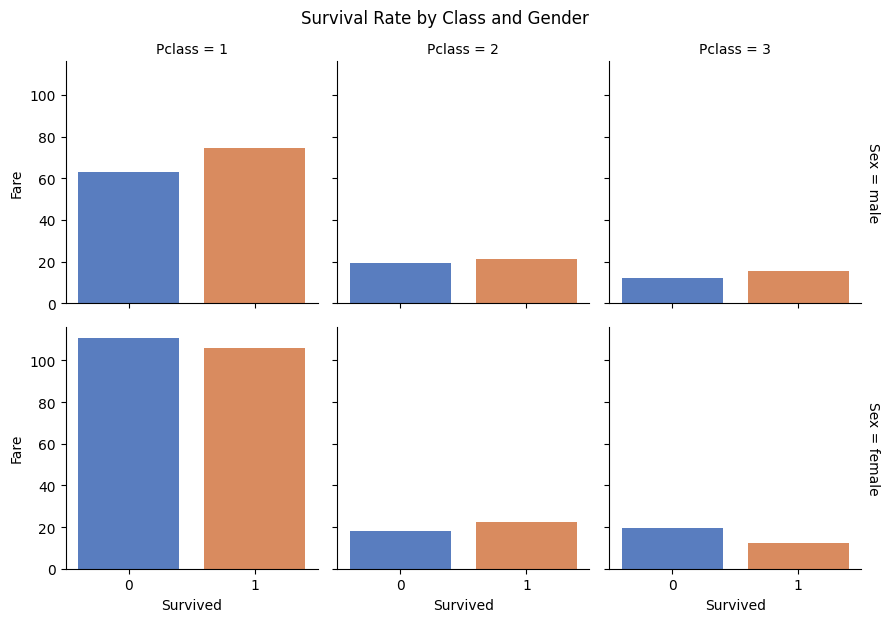

In [45]:
g = sns.FacetGrid(df, col='Pclass', row='Sex', margin_titles=True)
g.map_dataframe(sns.barplot, x='Survived', y='Fare', hue='Survived', errorbar=None, palette='muted')
g.set_axis_labels('Survived', 'Fare')
g.fig.suptitle('Survival Rate by Class and Gender', y=1.03)
plt.show()


Animate a time series plot of cumulative passenger fares over time:

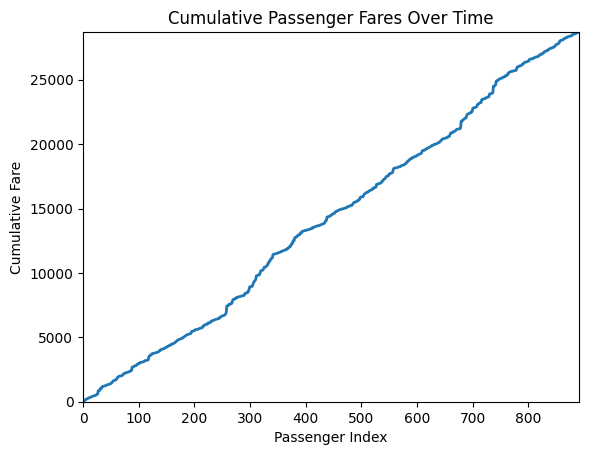

In [46]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Load the dataset
# url = "https://raw.githubusercontent.com/datasciencedojo/datasets/master/titanic.csv"
# df = pd.read_csv(url)

# Create figure
fig, ax = plt.subplots()
line, = ax.plot([], [], lw=2)

# Set axes limits
ax.set_xlim(0, len(df))
ax.set_ylim(0, df['Fare'].cumsum().max())

# Title and labels
ax.set_title('Cumulative Passenger Fares Over Time')
ax.set_xlabel('Passenger Index')
ax.set_ylabel('Cumulative Fare')

# Initialize function
def init():
    line.set_data([], [])
    return line,

# Animation function
def animate(i):
    x = list(range(i))
    y = df['Fare'].cumsum().iloc[:i]
    line.set_data(x, y)
    return line,

# Call animation
ani = animation.FuncAnimation(fig, animate, init_func=init, frames=len(df), interval=10, blit=True)

# Display the animation
HTML(ani.to_jshtml())


Create a hexbin plot of Age vs Fare:

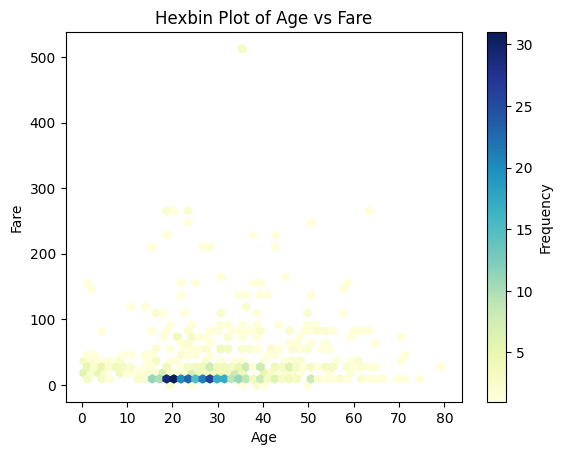

In [47]:
plt.hexbin(df['Age'], df['Fare'], gridsize=50, cmap='YlGnBu', mincnt=1)
cb = plt.colorbar(label='Frequency')
plt.title('Hexbin Plot of Age vs Fare')
plt.xlabel('Age')
plt.ylabel('Fare')
plt.show()


Plot the survival rate by age group using a violin plot:

<ipython-input-48-5168c92dff9a>:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='AgeGroup', y='Survived', data=df, split=True, palette='muted', inner='quart')


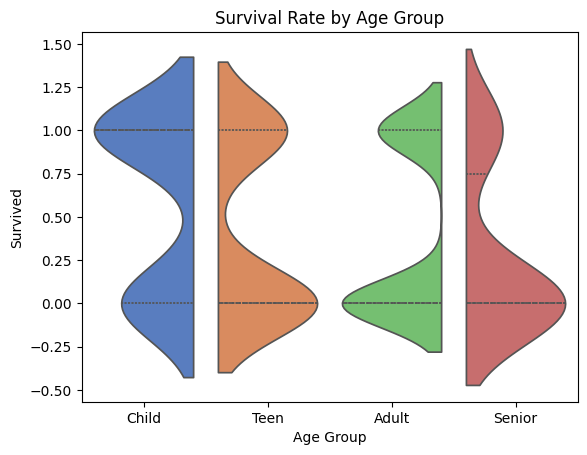

In [48]:
sns.violinplot(x='AgeGroup', y='Survived', data=df, split=True, palette='muted', inner='quart')
plt.title('Survival Rate by Age Group')
plt.xlabel('Age Group')
plt.ylabel('Survived')
plt.show()


Plot the data using a 3D scatter plot with Age, Fare, and Pclass:

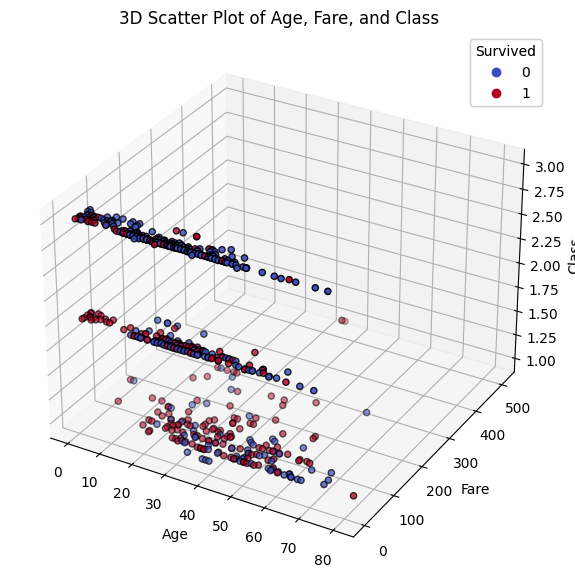

In [49]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(df['Age'], df['Fare'], df['Pclass'], c=df['Survived'], cmap='coolwarm', edgecolor='k')
ax.set_title('3D Scatter Plot of Age, Fare, and Class')
ax.set_xlabel('Age')
ax.set_ylabel('Fare')
ax.set_zlabel('Class')
legend1 = ax.legend(*sc.legend_elements(), title='Survived')
ax.add_artist(legend1)
plt.show()


Create a swarm plot of the passenger's age by class and survival status:

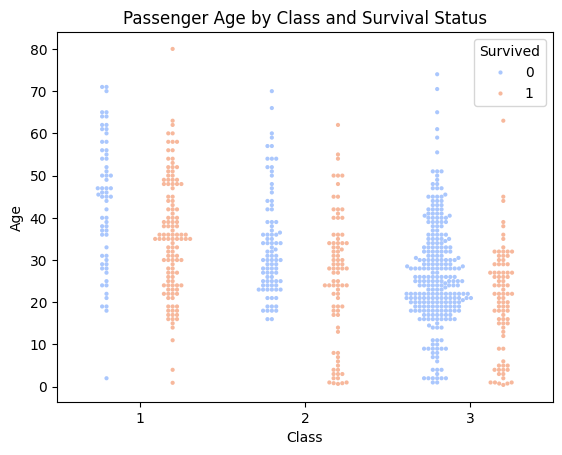

In [51]:
sns.swarmplot(x='Pclass', y='Age', hue='Survived', data=df, palette='coolwarm', dodge=True, size=3)
plt.title('Passenger Age by Class and Survival Status')
plt.xlabel('Class')
plt.ylabel('Age')
plt.legend(title='Survived')
plt.show()
